# Energy Preserving Operator Inference Optimization Example using Periodic BC Burger's Equation

In this notebook, we conduct the numerical experiment for the energy-preserving Operator Inference (ep-OpInf) for both the hard equality constraint and soft inequality constraint.

## Packages

In [1]:
using CSV
using DataFrames
using FileIO
using JLD2
using LaTeXStrings
using LinearAlgebra
using NaNStatistics
using Plots
using ProgressMeter
using Random
using SparseArrays
using Statistics
using Tables
;

## Initial Setup

In [2]:
include("../src/model/Burgers.jl")
include("../src/LiftAndLearn.jl")
const LnL = LiftAndLearn
;

In [3]:
# First order Burger's equation setup
burger = Burgers(
    [0.0, 1.0], [0.0, 1.0], [0.05, 0.15],
    2^(-7), 1e-4, 6, "periodic"
)
;

## Energy Preserving Constraint Optimization

In [4]:
# Create file name to save data
filename = "data/epOpInf_periodic_data_test2.jld2"
;

### Important Parameters

In [5]:
# Minimum and maximum dimensions
rmin = 1
rmax = 15

burger_system = LnL.sys_struct(
    is_lin=true,
    is_quad=true,
)
burger_vars = LnL.vars(
    N=1,
)
burger_data = LnL.data(
    Δt=1e-4,
    DS=100,
)
burger_optim = LnL.opt_settings(
    verbose=false,
    initial_guess=false,
    max_iter=500,
    reproject=false,
    SIGE=true,
)

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Downsampling rate
DS = burger_data.DS

# Down-sampled dimension of the time data
Tdim_ds = size(1:DS:burger.Tdim, 1)  # downsampled time dimension

# Number of random test inputs
num_test_ic = 10
;

#### Run below to change to periodic boundary condition
- Initial condition to: sinusoidal wave
    - with three parameters: amplitude ($A$), frequency ($a$), and phase ($b$)
- Zero boundary condition

A different initial condition:


$$
\begin{gather*}
    x(\omega, 0) = \exp(-a\cos^2(\pi x+b)) - c
\end{gather*}
$$

where $a, b, c$ are the three parameters to adjust.

In [ ]:
# Parameters for the initial condition
a = [2, 4, 6]
b = [-0.5, 0, 0.5]
c = [-0.25, 0, 0.25]
num_ic_params = Int(length(a)*length(b)*length(c))

# Parameterized initial condition
init_wave = (a,b,c) -> exp.(-a * cos.(π .* burger.x .+ b).^2) .- c

In [6]:
# Parameters of the initial condition
AMP = [0.8, 1.0, 1.2]
FREQ = [1, 2, 3]
PHASE = [-0.5, 0, 0.5]
num_ic_params = Int(length(AMP) * length(FREQ) * length(PHASE))

# Parameterized function for the initial condition
init_wave = (A,a,b) -> A .* sin.(2 * pi * a * burger.x .+ b) 
;  

### Generate Training Data

In [7]:
# Store values
Xtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training state data 10x1
Rtr = Vector{Matrix{Float64}}(undef, burger.Pdim)  # training derivative data 10x1
Xtr_all = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_ic_params)  # all training data 10x27
Vrmax = Vector{Matrix{Float64}}(undef, burger.Pdim)  # POD basis 10x1
op_fom_tr = Vector{LnL.operators}(undef, burger.Pdim)  # FOM operators 10x1

@info "Generate the FOM system matrices and training data."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A, F = burger.generateEPmatrix(burger, μ)
    op_fom_tr[i] = LnL.operators(A=A, F=F)

    # Store the training data 
    Xall = Vector{Matrix{Float64}}(undef, num_ic_params)
    Xdotall = Vector{Matrix{Float64}}(undef, num_ic_params)
    
    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for amp in AMP, freq in FREQ, phase in PHASE
        states = burger.semiImplicitEuler(A, F, burger.t, init_wave(amp, freq, phase))
        Xtr_all[i,ct] = states
        
        tmp = states[:, 2:end]
        Xall[ct] = tmp[:, 1:DS:end]  # downsample data
        tmp = (states[:, 2:end] - states[:, 1:end-1]) / burger.Δt
        Xdotall[ct] = tmp[:, 1:DS:end]  # downsample data

        ct += 1  # increment counter
    end
    # Combine all initial condition data to form on big training data matrix
    Xtr[i] = reduce(hcat, Xall) 
    Rtr[i] = reduce(hcat, Xdotall)
    
    # Compute the POD basis from the training data
    tmp = svd(Xtr[i])
    Vrmax[i] = tmp.U[:, 1:rmax]
end

Data = Dict("Xtr" => Xtr, "Rtr" => Rtr, "Vrmax" => Vrmax, 
        "op_fom_tr" => op_fom_tr, "Xtr_all" => Xtr_all)
@save filename Data

┌ Info: Generate the FOM system matrices and training data.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:8


Progress:  33%|██████████████                           |  ETA: 0:59:28

Progress:  50%|█████████████████████                    |  ETA: 0:44:57

Progress:  67%|████████████████████████████             |  ETA: 0:30:10

Progress:  83%|███████████████████████████████████      |  ETA: 0:15:09

Progress: 100%|█████████████████████████████████████████| Time: 1:31:17


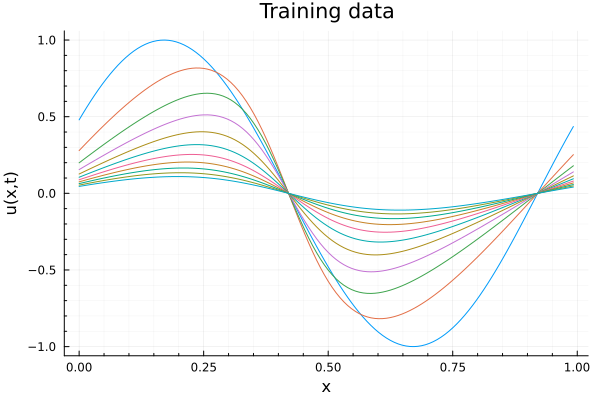

In [8]:
p1 = plot()
for i in 1:1000:burger.Tdim
    plot!(p1, burger.x, Xtr_all[1,12][:, i])
end
plot!(p1, xlabel="x", ylabel="u(x,t)", title="Training data", grid=true,
    minorgrid=true, legend=false)

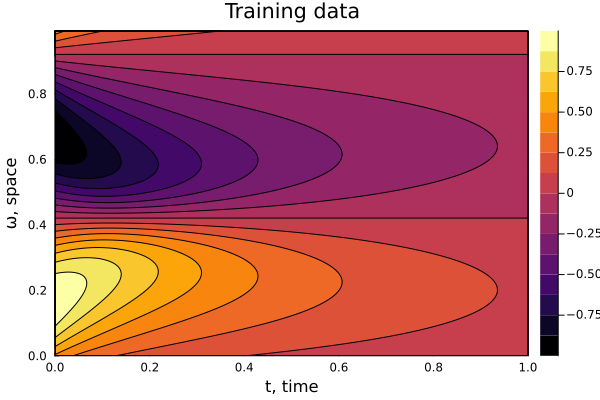

In [9]:
plot(contour(burger.t, burger.x, Xtr_all[1,12], fill=true), xlabel="t, time", ylabel="ω, space", zlabel="u(x,t)", title="Training data")

### Generate Test Data (Inside Training Region)

10 random amplitude, frequency, and phase from the training region for $\mu \in M$.

However, for the frequency, we draw a value from the training frequency array since it has to have a period of 1.

In [ ]:
# Store values
Xtest_in = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_in = Matrix{Vector{Float64}}(undef, burger.Pdim, num_test_ic)  # all initial conditions

@info "Generate test data for parameters within the training region."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate 10 random amplitude, frequency, and phase values
    AMP_test = (maximum(AMP) - minimum(AMP)) .* rand(num_test_ic) .+ minimum(AMP)
    FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
    PHASE_test = (maximum(PHASE) - minimum(PHASE)) .* rand(num_test_ic) .+ minimum(PHASE)

    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for amp in AMP_test, freq in FREQ_test, phase in PHASE_test
        Xtest_in[i,ct] = burger.semiImplicitEuler(A, F, burger.t, init_wave(amp, freq, phase))
        IC_test_in[i,ct] = init_wave(amp, freq, phase)
        ct += 1  # increment counter
    end
end

Data["Xtest_in"] = Xtest_in
Data["IC_test_in"] = IC_test_in
@save filename Data

### Generate Test Data (Outside Training Region)

10 random amplitude, frequency, and phase outside of the training region for $\mu \in M$.



In [ ]:
# Store values
Xtest_out = Matrix{Matrix{Float64}}(undef, burger.Pdim, num_test_ic)  # all training data 
IC_test_out = Matrix{Vector{Float64}}(undef, burger.Pdim, num_test_ic)  # all initial conditions

@info "Generate test data for parameters within the training region."
@showprogress for i in 1:length(burger.μs)
    μ = burger.μs[i]

    # Generate the FOM system matrices (ONLY DEPENDS ON μ)
    A = op_fom_tr[i].A
    F = op_fom_tr[i].F

    # Generate 10 random amplitude, frequency, and phase values
    AMP_test = (minimum(AMP) - 0.2) .* rand(num_test_ic/2) .+ 0.2
    append!(AMP_test, (1.8 - maximum(AMP)) .* rand(num_test_ic/2) .+ maximum(AMP))
    FREQ_test = [rand(FREQ) for i in 1:num_test_ic]
    PHASE_test = (minimum(PHASE) - 1.0) .* rand(num_test_ic/2) .- 1.0
    append!(PHASE_test, (1.0 - maximum(PHASE)) .* rand(num_test_ic/2) .+ maximum(PHASE))

    # Generate the data for all combinations of the initial condition parameters
    ct = 1  # set/reset counter
    for amp in AMP_test, freq in FREQ_test, phase in PHASE_test
        Xtest_out[i,ct] = burger.semiImplicitEuler(A, F, burger.t, init_wave(amp, freq, phase))
        IC_test_out[i,ct] = init_wave(amp, freq, phase)
        ct += 1  # increment counter
    end
end

Data["Xtest_out"] = Xtest_out
Data["IC_test_out"] = IC_test_out
@save filename Data

### Obtain OpInf Least-Squares Operators

In [14]:
@info "Compute the Least Squares solution."

options = LnL.LS_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    pinv_tol = 1e-5,          # tolerance for pseudo-inverse
)

# Store values
op_LS = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    @info "Data loaded."
end

@showprogress for i in 1:length(burger.μs)
    op_LS[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
end

# Save to data
Data["op_LS"] = op_LS
save(filename, Data)

┌ Info: Compute the Least Squares solution.
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1
┌ Warning: Rank difficient, rank = 100, tol = 8.200887590950295e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 89, tol = 8.07426420986216e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress:  33%|██████████████                           |  ETA: 0:00:10

┌ Warning: Rank difficient, rank = 82, tol = 9.698331245853605e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 75, tol = 9.906177683146084e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress:  67%|████████████████████████████             |  ETA: 0:00:03

┌ Warning: Rank difficient, rank = 72, tol = 7.850043712138265e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89


┌ Warning: Rank difficient, rank = 71, tol = 5.392329830842872e-6.
└ @ Main.LiftAndLearn c:\Users\tkoike3\Code\LiftAndLearn.jl\src\learn.jl:89
Progress: 100%|█████████████████████████████████████████| Time: 0:00:05


### Obtain intrusive operators 

In [16]:
@info "Compute the intrusive model"

# Store values
op_int = Array{LnL.operators}(undef, burger.Pdim)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Vrmax = Data["Vrmax"]
    op_fom_tr = Data["op_fom_tr"]
    @info "Data loaded."
end

for i in 1:length(burger.μs)
    # Compute the values for the intrusive model from the basis of the training data
    op_int[i] = LnL.intrusiveMR(op_fom_tr[i], Vrmax[i], options)
    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_int"] = op_int
save(filename, Data)

┌ Info: Compute the intrusive model
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:1


┌ Info: Loop 1 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 2 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 3 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 4 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 5 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21
┌ Info: Loop 6 out of 6 completed...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:21


### Obtain operators for EPHEC-OpInf

In [ ]:
@info "Compute the EPHEC model"

options = LnL.EPHEC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from data file..."
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# for i in 1:length(burger.μs)
#     if test == 1
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         op_ephec_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_tmp = LnL.operators()
#         for j in rmin:rmax
#             if j == rmin
#                 options.optim.initial_guess = false
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options)
#             else
#                 options.optim.initial_guess = true
#                 op_tmp = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, op_tmp)
#             end

#             if j != rmax
#                 op_tmp.A = [op_tmp.A zeros(j, 1); zeros(1, j+1)]
#                 op_tmp.F = Matrix(LnL.insert2F(op_tmp.F, j+1))
#             else
#                 op_ephec_opinf[i] = op_tmp
#             end
#         end
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_ephec = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_ephec[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_ephec[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_ephec[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_ephec"] = op_ephec
save(filename, Data)

### Obtain operators for EPSIC-OpInf

In [ ]:
@info "Compute the EPSIC OpInf."

options = LnL.EPSIC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    ϵ=1e-3,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the epsic-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = false
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
#     elseif test == 3
#         op_epsic_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epsic = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epsic[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epsic[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epsic[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epsic"] = op_epsic
save(filename, Data)

### Obtain operators for EPUC-OpInf

In [ ]:
@info "Compute the EPUC OpInf."

options = LnL.EPUC_options(
    system=burger_system,
    vars=burger_vars,
    data=burger_data,
    optim=burger_optim,
    α=1e6,
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    # op_guess = test==3 ? Data["op_rand"] : nothing
    Xtr = Data["Xtr"]
    Rtr = Data["Rtr"]
    Vrmax = Data["Vrmax"]
    op_int = Data["op_int"]
    @info "Data loaded."
end

# @info "Compute the EPUC-OpInf operators"
# for i in 1:length(burger.μs)
#     # Compute non-constrained OpInf (the initial guess is the non-constrained operator inference operators)
#     if test == 1
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_int[i])
#     elseif test == 2
#         options.optim.initial_guess = true
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_LS[i])
#     elseif test == 3
#         op_epuc_opinf[i] = LnL.inferOp(Xtr[i], zeros(1,1), zeros(1,1), Vrmax[i], Vrmax[i]' * Rtr[i], options, op_guess[i])
#     end
#     @info "Loop $(i) out of 10 completed..."
# end

op_epuc = options.optim.SIGE ? Array{LnL.operators}(undef, burger.Pdim, rmax-rmin+1) : Array{LnL.operators}(undef, burger.Pdim)

for i in 1:length(burger.μs)
    if options.optim.SIGE
        options.optim.initial_guess = false  # turn off initial guess for the first iteration
        op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:rmin], Vrmax[i][:,1:rmin]' * Rtr[i], options)  # compute the first operator
        op_epuc[i, 1] = op_tmp  # store the first operator
        for j in rmin+1:rmax
            options.optim.initial_guess = true  # turn on initial guess for the rest of the iterations
            op_tmp = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i][:,1:j], Vrmax[i][:,1:j]' * Rtr[i], options, LnL.operators(A=op_tmp.A, F=op_tmp.F)) # compute the rest of the operators
            op_epuc[i, j] = op_tmp # store the rest of the operators
        end
    else 
        # Use Ipopt default initial guess
        options.optim.initial_guess = false 
        op_epuc[i] = LnL.inferOp(Xtr[i], zeros(Tdim_ds,1), zeros(Tdim_ds,1), Vrmax[i], Vrmax[i]' * Rtr[i], options)
    end

    @info "Loop $(i) out of $(burger.Pdim) completed..."
end

# Save to data
Data["op_epuc"] = op_epuc
save(filename, Data)

### Test & Analyze (Training Data)

In [26]:
# Projection error
train_proj_err = zeros(rmax - (rmin-1), burger.Pdim) 
# Relative state error
train_state_err = Dict(
    :int => zeros(rmax-rmin+1, burger.Pdim),
    :LS => zeros(rmax-rmin+1, burger.Pdim),
    :ephec => zeros(rmax-rmin+1, burger.Pdim),
    :epsic => zeros(rmax-rmin+1, burger.Pdim),
    :epuc => zeros(rmax-rmin+1, burger.Pdim),
)
# Energy 
train_En = Dict(
    :int => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :epsic => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :epuc => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{VecOrMat{Float64}}(undef, burger.Pdim)
)
# Constraint Residual
train_CR = Dict(
    :int => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :epsic => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :epuc => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{Float64}(undef, burger.Pdim)
)
# Momentum
train_mmt = Dict(
    :int => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :epsic => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :epuc => Array{Float64}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{Float64}(undef, burger.Pdim)
)
# Constraint Violation
train_CV = Dict(
    :int => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :LS => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :ephec => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :epsic => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :epuc => Array{VecOrMat{Float64}}(undef, rmax - (rmin - 1), burger.Pdim),
    :fom => Array{VecOrMat{Float64}}(undef, burger.Pdim)
)

# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from $(filename)"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    op_LS = Data["op_LS"]
    op_int = Data["op_int"]
    op_ephec = Data["op_ephec"]
    op_epsic = Data["op_epsic"]
    op_epuc = Data["op_epuc"]
    
    Xtr_all = Data["Xtr_all"]
    Vrmax = Data["Vrmax"]
    @info "Data loaded."
end

@info "Analyze the operators with training data..."
@showprogress for i in 1:length(burger.μs)

    # Energy, constraint residual, and constraint violation of the FOM
    train_En[:fom][i] = norm.(eachcol(Xtr_all[i]), 2)
    F_full = Data["op_fom_tr"][i].F
    train_CR[:fom][i], train_mmt[:fom][i] = LnL.constraintResidual(F_full, size(F_full, 1), options.optim.which_quad_term)
    train_CV[:fom][i] = LnL.constraintViolation(Xtr_all[i], F_full, options.optim.which_quad_term)
    
    for (j,r) in enumerate(rmin:rmax)
        Vr = Vrmax[i][:, 1:r]

        # Temporary data storage
        PE = zeros(num_ic_params)  # projection error
        SE = Dict(
            :int => zeros(num_ic_params),
            :LS => zeros(num_ic_params),
            :ephec => zeros(num_ic_params),
            :epsic => zeros(num_ic_params),
            :epuc => zeros(num_ic_params),
        )
        En = Dict(
            :int => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :LS => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :ephec => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :epsic => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :epuc => Array{Float64}(undef, num_ic_params, burger.Tdim),
        )
        CR = Dict(
            :int => Array{Float64}(undef, num_ic_params),
            :LS => Array{Float64}(undef, num_ic_params),
            :ephec => Array{Float64}(undef, num_ic_params),
            :epsic => Array{Float64}(undef, num_ic_params),
            :epuc => Array{Float64}(undef, num_ic_params),
        )
        mmt = Dict(
            :int => Array{Float64}(undef, num_ic_params),
            :LS => Array{Float64}(undef, num_ic_params),
            :ephec => Array{Float64}(undef, num_ic_params),
            :epsic => Array{Float64}(undef, num_ic_params),
            :epuc => Array{Float64}(undef, num_ic_params),
        )
        CV = Dict(
            :int => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :LS => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :ephec => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :epsic => Array{Float64}(undef, num_ic_params, burger.Tdim),
            :epuc => Array{Float64}(undef, num_ic_params, burger.Tdim),
        )

        ct = 1  # set/reset counter
        for amp in AMP, freq in FREQ, phase in PHASE
            IC = init_wave(amp, freq, phase)

            # Integrate the LS operator inference model
            Finf_extract_LS = LnL.extractF(op_LS[i].F, r)
            Xinf_LS = burger.semiImplicitEuler(op_LS[i].A[1:r, 1:r], Finf_extract_LS, burger.t, Vr' * IC)

            # Integrate the intrusive model
            Fint_extract = LnL.extractF(op_int[i].F, r)
            Xint = burger.semiImplicitEuler(op_int[i].A[1:r, 1:r], Fint_extract, burger.t, Vr' * IC)
            
            if options.optim.SIGE
                # Integrate the energy-preserving hard equality constraint operator inference model
                Finf_extract_ephec = op_ephec[i,j].F
                Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,j].A, op_ephec[i,j].F, burger.t, Vr' * IC)
                # Finf_extract_ephec = LnL.extractF(op_ephec[i,rmax].F, r)
                # Xinf_ephec = burger.semiImplicitEuler(op_ephec[i,rmax].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * IC)
                
                # Integrate the energy-preserving soft inequality constraint operator inference model
                Finf_extract_epsic = op_epsic[i,j].F
                Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,j].A, op_epsic[i,j].F, burger.t, Vr' * IC)
                # Finf_extract_epsic = LnL.extractF(op_epsic[i,rmax].F, r)
                # Xinf_epsic = burger.semiImplicitEuler(op_epsic[i,rmax].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * IC)

                # Integrate the energy-preserving unconstrained operator inference model
                Finf_extract_epuc = op_epuc[i,j].F
                Xinf_epuc = burger.semiImplicitEuler(op_epuc[i,j].A, op_epuc[i,j].F, burger.t, Vr' * IC)
                # Finf_extract_epuc = LnL.extractF(op_epuc[i,rmax].F, r)
                # Xinf_epuc = burger.semiImplicitEuler(op_epuc[i,rmax].A[1:r, 1:r], Finf_extract_epuc, burger.t, Vr' * IC)
            else
                # Integrate the energy-preserving hard equality constraint operator inference model
                Finf_extract_ephec = LnL.extractF(op_ephec[i].F, r)
                Xinf_ephec = burger.semiImplicitEuler(op_ephec[i].A[1:r, 1:r], Finf_extract_ephec, burger.t, Vr' * IC)
                
                # Integrate the energy-preserving soft inequality constraint operator inference model
                Finf_extract_epsic = LnL.extractF(op_epsic[i].F, r)
                Xinf_epsic = burger.semiImplicitEuler(op_epsic[i].A[1:r, 1:r], Finf_extract_epsic, burger.t, Vr' * IC)

                # Integrate the energy-preserving unconstrained operator inference model
                Finf_extract_epuc = LnL.extractF(op_epuc[i].F, r)
                Xinf_epuc = burger.semiImplicitEuler(op_epuc[i].A[1:r, 1:r], Finf_extract_epuc, burger.t, Vr' * IC)
            end

            # Compute the projection error
            PE[ct] = LnL.compProjError(Xtr_all[i,ct], Vr)

            # Compute the relative state error
            SE[:LS][ct] = LnL.compStateError(Xtr_all[i,ct][:, 1:DS:end], Xinf_LS[:, 1:DS:end], Vr)
            SE[:int][ct] = LnL.compStateError(Xtr_all[i,ct][:, 1:DS:end], Xint[:, 1:DS:end], Vr)
            SE[:ephec][ct] = LnL.compStateError(Xtr_all[i,ct][:, 1:DS:end], Xinf_ephec[:, 1:DS:end], Vr)
            SE[:epsic][ct] = LnL.compStateError(Xtr_all[i,ct][:, 1:DS:end], Xinf_epsic[:, 1:DS:end], Vr)
            SE[:epuc][ct] = LnL.compStateError(Xtr_all[i,ct][:, 1:DS:end], Xinf_epuc[:, 1:DS:end], Vr)

            # Compute the energy
            En[:LS][ct, :] .= norm.(eachcol(Vr * Xinf_LS), 2)
            En[:int][ct, :] .= norm.(eachcol(Vr * Xint), 2)
            En[:ephec][ct, :] .= norm.(eachcol(Vr * Xinf_ephec), 2)
            En[:epsic][ct, :] .= norm.(eachcol(Vr * Xinf_epsic), 2)
            En[:epuc][ct, :] .= norm.(eachcol(Vr * Xinf_epuc), 2)

            # Compute the constraint residual and momentum
            CR[:LS][ct], mmt[:LS][ct] =  LnL.constraintResidual(Finf_extract_LS, r, options.optim.which_quad_term)
            CR[:int][ct], mmt[:int][ct] = LnL.constraintResidual(Fint_extract, r, options.optim.which_quad_term)
            CR[:ephec][ct], mmt[:ephec][ct] = LnL.constraintResidual(Finf_extract_ephec, r, options.optim.which_quad_term)
            CR[:epsic][ct], mmt[:epsic][ct] = LnL.constraintResidual(Finf_extract_epsic, r, options.optim.which_quad_term)
            CR[:epuc][ct], mmt[:epuc][ct] = LnL.constraintResidual(Finf_extract_epuc, r, options.optim.which_quad_term)

            # Compute the constraint violation
            CV[:LS][ct, :] .= LnL.constraintViolation(Xinf_LS, Finf_extract_LS, options.optim.which_quad_term)
            CV[:int][ct, :] .= LnL.constraintViolation(Xint, Fint_extract, options.optim.which_quad_term)
            CV[:ephec][ct, :] .= LnL.constraintViolation(Xinf_ephec, Finf_extract_ephec, options.optim.which_quad_term)
            CV[:epsic][ct, :] .= LnL.constraintViolation(Xinf_epsic, Finf_extract_epsic, options.optim.which_quad_term)
            CV[:epuc][ct, :] .= LnL.constraintViolation(Xinf_epuc, Finf_extract_epuc, options.optim.which_quad_term)

            # Increment counter
            ct += 1
        end

        # Compute errors
        train_proj_err[j, i] = mean(PE)
        train_state_err[:LS][j, i] = mean(SE[:LS])
        train_state_err[:int][j, i] = mean(SE[:int])
        train_state_err[:ephec][j, i] = mean(SE[:ephec])
        train_state_err[:epsic][j, i] = mean(SE[:epsic])
        train_state_err[:epuc][j, i] = mean(SE[:epuc])
        
        # Compute energy 
        train_En[:LS][j, i] = mean(En[:LS], dims=1)
        train_En[:int][j, i] = mean(En[:int], dims=1)
        train_En[:ephec][j, i] = mean(En[:ephec], dims=1)
        train_En[:epsic][j, i] = mean(En[:epsic], dims=1)
        train_En[:epuc][j, i] = mean(En[:epuc], dims=1)
        
        # Compute the CR and momentum
        train_CR[:LS][j, i] = mean(CR[:LS])
        train_CR[:int][j, i] = mean(CR[:int])
        train_CR[:ephec][j, i] = mean(CR[:ephec])
        train_CR[:epsic][j, i] = mean(CR[:epsic])
        train_CR[:epuc][j, i] = mean(CR[:epuc])

        train_mmt[:LS][j, i] = mean(mmt[:LS])
        train_mmt[:int][j, i] = mean(mmt[:int])
        train_mmt[:ephec][j, i] = mean(mmt[:ephec])
        train_mmt[:epsic][j, i] = mean(mmt[:epsic])
        train_mmt[:epuc][j, i] = mean(mmt[:epuc])

        # Compute constraint violations
        train_CV[:LS][j, i] = mean(CV[:LS], dims=1)
        train_CV[:int][j, i] = mean(CV[:int], dims=1)
        train_CV[:ephec][j, i] = mean(CV[:ephec], dims=1)
        train_CV[:epsic][j, i] = mean(CV[:epsic], dims=1)
        train_CV[:epuc][j, i] = mean(CV[:epuc], dims=1)
    end
end

# Save data
Data["train_proj_err"] = train_proj_err
Data["train_state_err"] = train_state_err
Data["train_En"] = train_En
Data["train_CR"] = train_CR
Data["train_mmt"] = train_mmt
Data["train_CV"] = train_CV
save(filename, Data)

┌ Info: Analyze the operators with training data...
└ @ Main c:\Users\tkoike3\Code\LiftAndLearn.jl\examples\08_ep-burgers_ep-OpInf.ipynb:66


### Results

In [5]:
# Load the data dictionary
if !(@isdefined Data)
    @info "Loading data from epOpInf_periodic_data.jld2"
    if !isfile(filename)
        error("Run the cell above to generate the data first!")
    end
    Data = load(filename)
    @info "Data loaded."
end
;

### Training Data

#### Projection Error

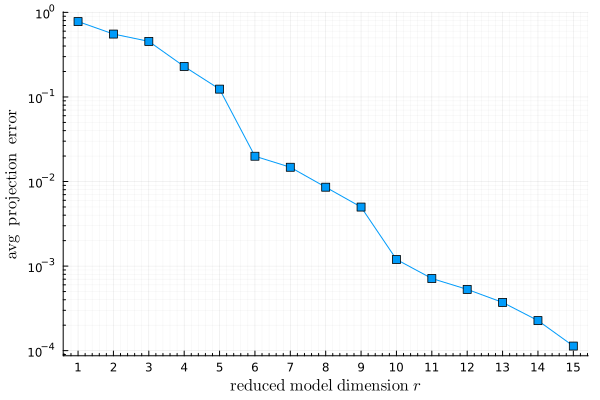

In [24]:
# Training data
mean_train_proj_err = mean(Data["train_proj_err"], dims=2)
plot(rmin:rmax, mean_train_proj_err, marker=(:rect))
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=false)
tmp = log10.(mean_train_proj_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~projection~~error}")

#### Mean relative state error

In [20]:
DataFrame(Data["train_state_err"][:LS], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.793652,0.786707,0.783067,0.780895,0.779489,0.778518
2,0.565969,0.557885,0.554349,0.552388,0.551178,0.550365
3,0.476084,0.466177,0.460923,0.457324,0.454674,0.452701
4,0.255465,0.242306,0.236499,0.232345,0.229394,0.227202
5,0.149412,0.132643,0.125894,0.121656,0.119058,0.117268
6,0.119104,0.248842,0.0242759,0.0188837,0.0153401,0.0132572
7,0.0663398,0.0832932,0.0195972,0.0148143,0.0114093,0.00999189
8,0.0618585,0.0258348,0.0121136,0.00809625,0.00645345,0.00541217
9,0.0918677,NaN,0.0108543,0.004828,0.00377396,0.00318148


In [22]:
DataFrame(Data["train_state_err"][:int], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.793541,0.786705,0.783065,0.780895,0.779489,0.778518
2,0.565597,0.557875,0.554329,0.552381,0.551175,0.550362
3,0.472059,0.464425,0.459706,0.45644,0.454074,0.452299
4,0.249627,0.240469,0.235109,0.23146,0.228812,0.226807
5,0.146862,0.132311,0.125485,0.121587,0.119047,0.117237
6,0.0422387,0.0289427,0.0222861,0.0181786,0.0153154,0.0131617
7,0.0318662,0.0216168,0.0166089,0.0135125,0.0113318,0.00967518
8,0.0183891,0.0125148,0.00962321,0.00776445,0.00640599,0.00534623
9,0.0116677,0.00742266,0.00555355,0.00442976,0.00363329,0.00302092


In [23]:
DataFrame(Data["train_state_err"][:ephec], :auto)

Row,x1,x2,x3,x4,x5,x6
,Float64,Float64,Float64,Float64,Float64,Float64
1,0.793546,0.786707,0.783065,0.780895,0.779489,0.778518
2,0.565609,0.557882,0.554334,0.552385,0.551178,0.550365
3,0.471078,0.465066,0.459618,0.456552,0.453918,0.452212
4,0.248744,0.24084,0.234915,0.231547,0.228652,0.226756
5,NaN,NaN,NaN,0.141613,0.123434,0.118195
6,NaN,NaN,NaN,0.0903449,0.0174796,0.0174712
7,NaN,NaN,NaN,0.0866808,0.0138408,0.0141597
8,NaN,NaN,NaN,0.0207986,0.0236381,NaN
9,NaN,NaN,NaN,0.0856031,0.0825442,NaN


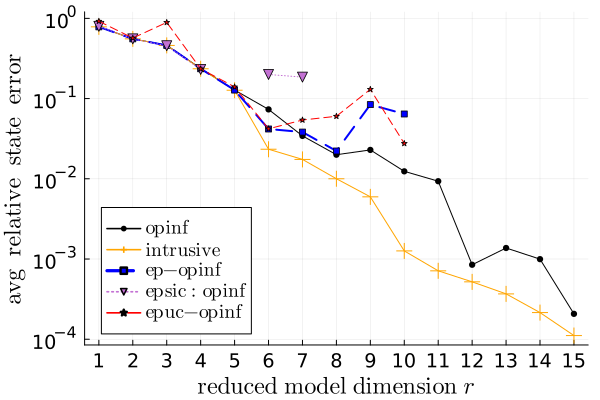

In [25]:
# Training data
c1,c2,c3,c4,c5 = palette(:default)
mean_LS_state_err = nanmean(Data["train_state_err"][:LS], dims=2)
mean_int_state_err = mean(Data["train_state_err"][:int], dims=2)
mean_ephec_state_err = nanmean(Data["train_state_err"][:ephec], dims=2)
mean_epsic_state_err = nanmean(Data["train_state_err"][:epsic], dims=2)
mean_epuc_state_err = nanmean(Data["train_state_err"][:epuc], dims=2)

plot(rmin:rmax, mean_LS_state_err, c=:black, marker=(:circle, 3.5), label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_state_err, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_state_err, c=:blue, marker=(:rect, 3), ls=:dash, lw=2, label=L"\mathrm{ep}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_state_err, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}:\mathrm{opinf}")
plot!(rmin:rmax, mean_epuc_state_err, c=:red, marker=(:star, 3), lw=1, ls=:dash, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomleft)
tmp = log10.(mean_int_state_err)
yticks!([10.0^i for i in floor(minimum(tmp))-1:ceil(maximum(tmp))+1])
xticks!(rmin:rmax)
xlabel!(L"\mathrm{reduced~model~dimension~} r")
ylabel!(L"\mathrm{avg~~relative~~state~~error}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Total Energy

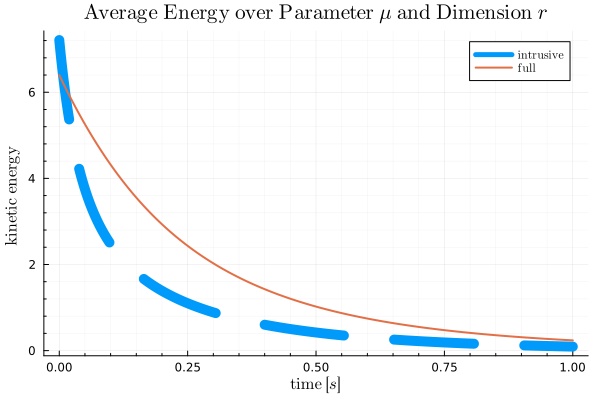

In [15]:
# Training data
mean_LS_En_tr = mean(Data["train_En"][:LS])'
mean_int_En_tr = mean(Data["train_En"][:int])'
mean_ephec_En_tr = mean(Data["train_En"][:ephec])'
mean_epsic_En_tr = mean(Data["train_En"][:epsic])'
mean_epuc_En_tr = mean(Data["train_En"][:epuc])'
mean_fom_En_tr = mean(Data["train_En"][:fom])

plot(burger.t, mean_int_En_tr, lw=10, ls=:dash, label=L"\mathrm{intrusive}")
# plot!(burger.t, mean_LS_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
# plot!(burger.t, mean_ephec_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic:opinf}")
# plot!(burger.t, mean_epuc_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_En_tr, lw=2, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:topright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{kinetic~energy~}")
title!(L"\mathrm{Average~Energy~over~Parameter}~\mu \mathrm{~and~Dimension~} r")

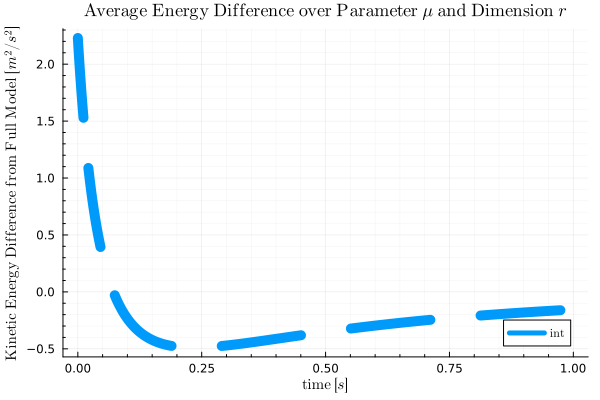

In [28]:
plot(burger.t, mean_int_En_tr - mean_fom_En_tr, lw=10, ls=:dash, label=L"\mathrm{int}")
# plot!(burger.t, mean_LS_En_tr - mean_fom_En_tr, lw=12, ls=:dash, label=L"\mathrm{LS}")
# plot!(burger.t, mean_ephec_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_En_tr - mean_fom_En_tr, lw=4, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epuc_En_tr - mean_fom_En_tr, lw=6, ls=:dashdot, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(majorgrid=true, minorgrid=true, legend=:bottomright)
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{Kinetic~Energy~Difference~from~Full~Model}~[m^2/s^2]", fontsize=(8))
title!(L"\mathrm{Average~Energy~Difference~over~Parameter}~\mu \mathrm{~and~Dimension~} r", titlefont = font(12))
plot!(guidefontsize=10)

#### Constraint Residual 

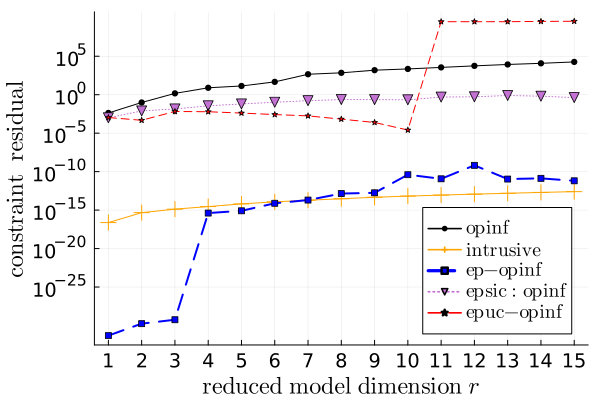

In [16]:
mean_LS_CR_tr = mean(Data["train_CR"][:LS], dims=2)
mean_int_CR_tr = mean(Data["train_CR"][:int], dims=2)
mean_ephec_CR_tr = mean(Data["train_CR"][:ephec], dims=2)
mean_epsic_CR_tr = mean(Data["train_CR"][:epsic], dims=2)
mean_epuc_CR_tr = mean(Data["train_CR"][:epuc], dims=2)
mean_fom_CR_tr = mean(Data["train_CR"][:fom])

plot(rmin:rmax, mean_LS_CR_tr, marker=(:circle, 3.5), c=:black, label=L"\mathrm{opinf}")
plot!(rmin:rmax, mean_int_CR_tr, c=:orange, marker=(:cross, 8), label=L"\mathrm{intrusive}")
plot!(rmin:rmax, mean_ephec_CR_tr, c=:blue, marker=(:rect, 3), lw=2, ls=:dash, label=L"\mathrm{ep}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_CR_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}:\mathrm{opinf}")
plot!(rmin:rmax, mean_epuc_CR_tr, c=:red, marker=(:star, 3), ls=:dash, lw=1, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, legend=:bottomright, minorgridalpha=0.03)
yticks!(10.0 .^ [-25, -20, -15, -10, -5, 0, 5])
xticks!(1:15)
xlabel!(L"\mathrm{reduced~model~dimension}~r")
ylabel!(L"\mathrm{constraint~~residual}")
plot!(guidefontsize=16, tickfontsize=13,  legendfontsize=13)

#### Momentum 

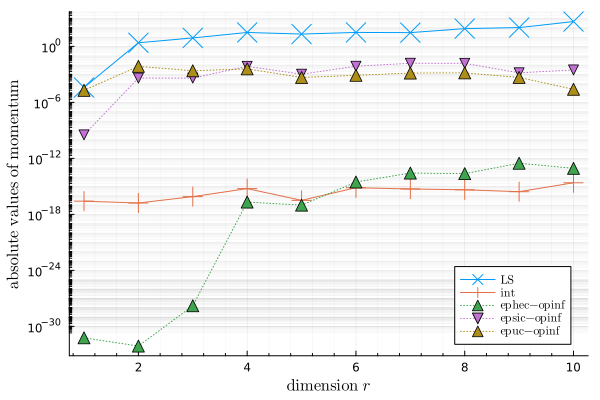

In [35]:
mean_LS_mmt_tr    = abs.(mean(Data["train_mmt"][:LS], dims=2))
mean_int_mmt_tr   = abs.(mean(Data["train_mmt"][:int], dims=2))
mean_ephec_mmt_tr = abs.(mean(Data["train_mmt"][:ephec], dims=2))
mean_epsic_mmt_tr = abs.(mean(Data["train_mmt"][:epsic], dims=2))
mean_epuc_mmt_tr = abs.(mean(Data["train_mmt"][:epuc], dims=2))
mean_fom_mmt_tr   = abs.(mean(Data["train_mmt"][:fom]))

plot(rmin:rmax, mean_LS_mmt_tr, marker=(:xcross, 10), label=L"\mathrm{LS}")
plot!(rmin:rmax, mean_int_mmt_tr, marker=(:cross, 10), label=L"\mathrm{int}")
plot!(rmin:rmax, mean_ephec_mmt_tr, marker=(:utriangle, 6), ls=:dot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epsic_mmt_tr, marker=(:dtriangle, 5), ls=:dot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
plot!(rmin:rmax, mean_epuc_mmt_tr, marker=(:utriangle, 6), ls=:dot, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(yscale=:log10, majorgrid=true, minorgrid=true, legend=:bottomright)
yticks!(10.0 .^ [-30, -24, -18, -12, -6, 0, 6])
xlabel!(L"\mathrm{dimension}~r")
ylabel!(L"\mathrm{absolute~values~of~momentum}")


#### Constraint Violation

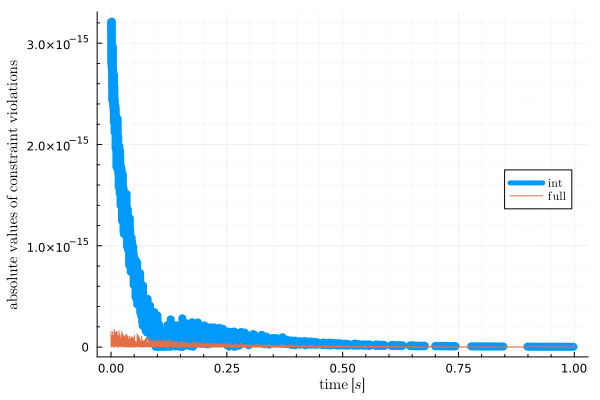

In [40]:
# Training data
mean_LS_CV_tr    = abs.(mean(Data["train_CV"][:LS]))'
mean_int_CV_tr   = abs.(mean(Data["train_CV"][:int]))'
mean_ephec_CV_tr = abs.(mean(Data["train_CV"][:ephec]))'
mean_epsic_CV_tr = abs.(mean(Data["train_CV"][:epsic]))'
mean_epuc_CV_tr = abs.(mean(Data["train_CV"][:epuc]))'
mean_fom_CV_tr   = abs.(mean(Data["train_CV"][:fom]))

plot(burger.t, mean_int_CV_tr, lw=8, ls=:dash, label=L"\mathrm{int}")
# plot!(burger.t, mean_LS_CV_tr, lw=6, ls=:dash, label=L"\mathrm{LS}")
# plot!(burger.t, mean_ephec_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{ephec}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epsic_CV_tr, lw=3, ls=:dashdotdot, label=L"\mathrm{epsic}\rm{-}\mathrm{opinf}")
# plot!(burger.t, mean_epuc_CV_tr, lw=3, ls=:dashdot, label=L"\mathrm{epuc}\rm{-}\mathrm{opinf}")
plot!(burger.t, mean_fom_CV_tr, lw=1, label=L"\mathrm{full}")
plot!(majorgrid=true, minorgrid=true, legend=:right)
# yticks!(10.0 .^ [-24, -21, -18, -15, -12, -9, -6, -3, 0])
xlabel!(L"\mathrm{time}~[s]")
ylabel!(L"\mathrm{absolute~values~of~constraint~violations}")
plot!(guidefontsize=10)